### Credit score classification

Given a person's credit information, we will create a machine learning model that can classify the credit score. To achieve our goal we will use supervised classification models, where we will evaluate the results to solve the problem and achieve the objective.

In [1]:
# all the libaries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import scipy.stats as stats
import warnings
warnings.filterwarnings('ignore')

Read the data from 'train.csv'

In [2]:
df = pd.read_csv('../Data/train.csv',low_memory=False)

FileNotFoundError: [Errno 2] No such file or directory: '../Data/train.csv'

#### DATA 

Age”: represents the age of the clients.

“Occupation”: represents the client's profession.

“Annual_Income”: annual income of the client.

“Monthly_Inhand_Salary”: monthly net salary of the client.

“Num_Bank_Accounts”: number of bank accounts that the client has.

“Num_Credit_Card”: number of credit cards that a client has.

“Type_of_Loan”: represents the types of loans that clients have.

“Num_of_Loan”: represents the amount of loans acquired by the client.

“Delay_from_due_date”: represents the average number of days of delay of the payment date (Days).

“Num_of_Delayed_Payment”: represents the average number of late payments for a person.

“Changed_Credit_Limit”: Represents the percentage increase in the credit card limit.

“Num_Credit_Inquiries”: represents the number of credit card inquiries.

“Credit_Mix”: represents the classification of varied credit (Bad, Standard, Good).

“Outstanding_Debt”: represents the remaining total of the client's debts to pay.

“Credit_Utilization_Ratio”: The credit card utilization ratio.

“Credit_History_Age”: represents the age of a person's credit history (Days).

“Payment_of_Min_Amount”: represents if the person only paid the minimum.

“Total_EMI_per_month”: represents the equivalent monthly installment (EMI:equated monthly installment).

“Amount_invested_monthly”: amount of money invested monthly.

“Payment_Behaviour”: represents the customer's payment habits.

“Monthly_Balance”: The client's monthly balance.

“Credit_Score”: Represents credit score support (Poor, Standard, Good).

### EDA

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  object 
 1   Customer_ID               100000 non-null  object 
 2   Month                     100000 non-null  object 
 3   Name                      90015 non-null   object 
 4   Age                       100000 non-null  object 
 5   SSN                       100000 non-null  object 
 6   Occupation                100000 non-null  object 
 7   Annual_Income             100000 non-null  object 
 8   Monthly_Inhand_Salary     84998 non-null   float64
 9   Num_Bank_Accounts         100000 non-null  int64  
 10  Num_Credit_Card           100000 non-null  int64  
 11  Interest_Rate             100000 non-null  int64  
 12  Num_of_Loan               100000 non-null  object 
 13  Type_of_Loan              88592 non-null   ob

In [ ]:
df.head(3).T

,0,1,2
ID,0x1602,0x1603,0x1604
Customer_ID,CUS_0xd40,CUS_0xd40,CUS_0xd40
Month,January,February,March
Name,Aaron Maashoh,Aaron Maashoh,Aaron Maashoh
Age,23,23,-500
SSN,821-00-0265,821-00-0265,821-00-0265
Occupation,Scientist,Scientist,Scientist
Annual_Income,19114.12,19114.12,19114.12
Monthly_Inhand_Salary,1824.843333,NaN,NaN
Num_Bank_Accounts,3,3,3


In [ ]:
df.describe()

,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Delay_from_due_date,Num_Credit_Inquiries,Credit_Utilization_Ratio,Total_EMI_per_month
count,84998.000000,100000.000000,100000.00000,100000.000000,100000.000000,98035.000000,100000.000000,100000.000000
mean,4194.170850,17.091280,22.47443,72.466040,21.068780,27.754251,32.285173,1403.118217
std,3183.686167,117.404834,129.05741,466.422621,14.860104,193.177339,5.116875,8306.041270
min,303.645417,-1.000000,0.00000,1.000000,-5.000000,0.000000,20.000000,0.000000
25%,1625.568229,3.000000,4.00000,8.000000,10.000000,3.000000,28.052567,30.306660
50%,3093.745000,6.000000,5.00000,13.000000,18.000000,6.000000,32.305784,69.249473
75%,5957.448333,7.000000,7.00000,20.000000,28.000000,9.000000,36.496663,161.224249
max,15204.633333,1798.000000,1499.00000,5797.000000,67.000000,2597.000000,50.000000,82331.000000


In [ ]:
df.isna().sum()

ID                              0
Customer_ID                     0
Month                           0
Name                         9985
Age                             0
SSN                             0
Occupation                      0
Annual_Income                   0
Monthly_Inhand_Salary       15002
Num_Bank_Accounts               0
Num_Credit_Card                 0
Interest_Rate                   0
Num_of_Loan                     0
Type_of_Loan                11408
Delay_from_due_date             0
Num_of_Delayed_Payment       7002
Changed_Credit_Limit            0
Num_Credit_Inquiries         1965
Credit_Mix                      0
Outstanding_Debt                0
Credit_Utilization_Ratio        0
Credit_History_Age           9030
Payment_of_Min_Amount           0
Total_EMI_per_month             0
Amount_invested_monthly      4479
Payment_Behaviour               0
Monthly_Balance              1200
Credit_Score                    0
dtype: int64

Variables with the incorrect format that need to be fixed.

We can observe erroneous data in potential variables to correct.

We found null data that we would have to handle.

Features that are not relevant to our analysis.

We need to analyze the outliers in the numerical variables

In [ ]:
# Every customer is assinged a customer id. we will use that customer id to match them and find the names for all the missing Name
print(f'Num of unique ID:{df["Customer_ID"].nunique()}')
print(f'Num of unique Name:{df["Name"].nunique()}')
df.groupby('Customer_ID')['Name'].count()

Num of unique ID:12500
Num of unique Name:10139


Customer_ID
CUS_0x1000    7
CUS_0x1009    8
CUS_0x100b    7
CUS_0x1011    8
CUS_0x1013    8
             ..
CUS_0xff3     6
CUS_0xff4     7
CUS_0xff6     8
CUS_0xffc     8
CUS_0xffd     7
Name: Name, Length: 12500, dtype: int64

*** Note: in future name customer id etc will not be used to build the model, they are mostly for referance ***

In [ ]:
df['Name'] = df.groupby('Customer_ID')['Name'].transform(lambda name: name.mode()[0]).astype("category") 

In [ ]:
df[df['Customer_ID']=='CUS_0x1000'].T

,56752,56753,56754,56755,56756,56757,56758,56759
ID,0x1628a,0x1628b,0x1628c,0x1628d,0x1628e,0x1628f,0x16290,0x16291
Customer_ID,CUS_0x1000,CUS_0x1000,CUS_0x1000,CUS_0x1000,CUS_0x1000,CUS_0x1000,CUS_0x1000,CUS_0x1000
Month,January,February,March,April,May,June,July,August
Name,Alistair Barrf,Alistair Barrf,Alistair Barrf,Alistair Barrf,Alistair Barrf,Alistair Barrf,Alistair Barrf,Alistair Barrf
Age,17,17,17_,17,17,18,18,18
SSN,913-74-1218,913-74-1218,913-74-1218,913-74-1218,913-74-1218,913-74-1218,913-74-1218,913-74-1218
Occupation,Lawyer,Lawyer,Lawyer,Lawyer,Lawyer,Lawyer,Lawyer,Lawyer
Annual_Income,30625.94,30625.94,30625.94_,30625.94,30625.94,30625.94,30625.94,30625.94
Monthly_Inhand_Salary,2706.161667,NaN,2706.161667,2706.161667,2706.161667,2706.161667,2706.161667,2706.161667
Num_Bank_Accounts,6,6,6,6,6,6,6,6


In [ ]:
# Age
print(df['Age'].describe())
df['Age'] = df['Age'].str.replace(r'[_\s-]', '', regex=True)
df['Age']=df['Age'].astype('float')

count     100000
unique      1788
top           38
freq        2833
Name: Age, dtype: object


In [ ]:
def plot_distribution(df, column_name):
    plt.figure(figsize=(8, 6))  # Adjust figure size for better readability
    sns.histplot(data=df, x=column_name, bins=30, kde=True, color='skyblue', edgecolor='black')  # Adding edgecolor for better visibility
    plt.title('Distribution of ' + column_name, fontsize=16, fontweight='bold')  # Increase font size and add bold
    plt.xlabel(column_name, fontsize=12)  # Increase font size
    plt.ylabel('Frequency', fontsize=12)  # Increase font size
    plt.grid(True, linestyle='--', alpha=0.6)  # Add gridlines with some transparency
    plt.tick_params(axis='both', which='major', labelsize=10)  # Adjust tick label size
    sns.despine()  # Remove the top and right spines
    plt.show()

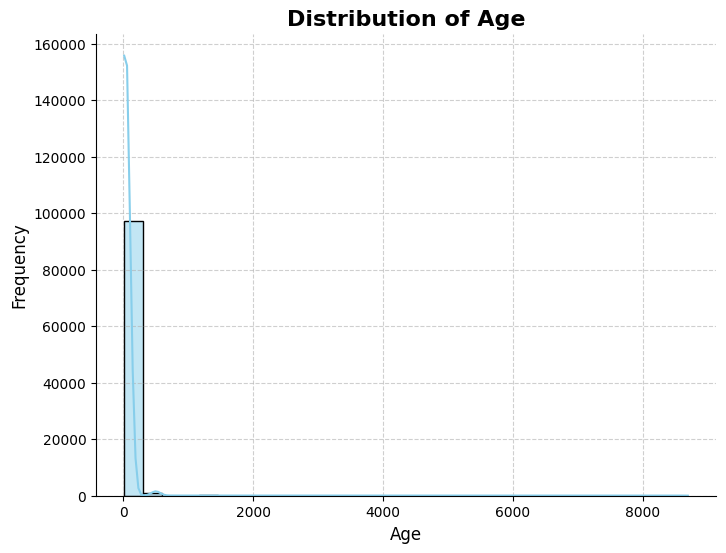

In [ ]:
plot_distribution(df,'Age')

In [ ]:
df['Age'] = df['Age'].apply(lambda x: np.NaN if x<0 or x>100 else x)

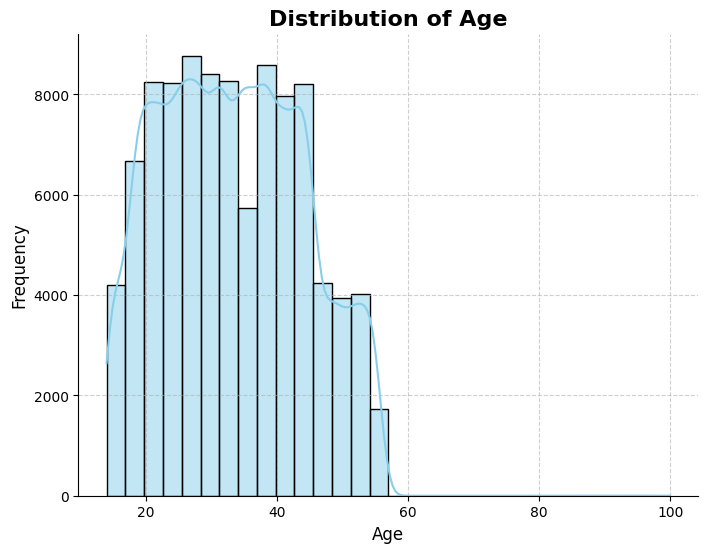

In [ ]:
plot_distribution(df,'Age')

In [ ]:
print(df['Age'].describe())
mode_age = df['Age'].mode()
print(f'Mode {mode_age[0]}')

count    97224.000000
mean        33.323274
std         10.778909
min         14.000000
25%         24.000000
50%         33.000000
75%         42.000000
max        100.000000
Name: Age, dtype: float64
Mode 38.0


Since we already dropped our outliears we can use mean to fill in our NaN

In [ ]:
df['Age']=df['Age'].fillna(df['Age'].mean())
df['Age'].isna().sum()

0

In [ ]:
def plot_sum_of_numarical_col_by_credit_score(col):
    sum__by_credit_score = df.groupby('Credit_Score')[col].sum().reset_index()
    plt.figure(figsize=(5, 3))
    sns.barplot(x='Credit_Score', y=col, data=sum__by_credit_score, palette='viridis', width=.5)
    plt.title(f'Sum {col} by Credit Score')
    plt.xlabel('Credit Score')
    plt.ylabel(f'Sum {col}')
    plt.show()

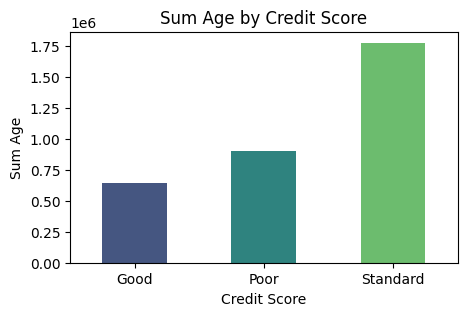

In [ ]:
plot_sum_of_numarical_col_by_credit_score('Age')

In [ ]:
# Occupation
df['Occupation'].unique()

array(['Scientist', '_______', 'Teacher', 'Engineer', 'Entrepreneur',
       'Developer', 'Lawyer', 'Media_Manager', 'Doctor', 'Journalist',
       'Manager', 'Accountant', 'Musician', 'Mechanic', 'Writer',
       'Architect'], dtype=object)

In [ ]:
df['Occupation'].value_counts()

Occupation
_______          7062
Lawyer           6575
Architect        6355
Engineer         6350
Scientist        6299
Mechanic         6291
Accountant       6271
Developer        6235
Media_Manager    6232
Teacher          6215
Entrepreneur     6174
Doctor           6087
Journalist       6085
Manager          5973
Musician         5911
Writer           5885
Name: count, dtype: int64

We will label all the rows who has '_______' to 'Unknown'

In [ ]:
df.loc[df['Occupation'] == '_______', 'Occupation'] = 'Unknown'

In [ ]:
df['Occupation']=df['Occupation'].astype('category')


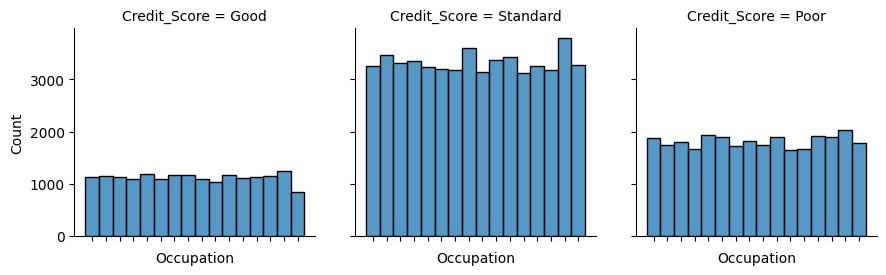

In [ ]:
Occupation = sns.FacetGrid(df, col='Credit_Score', height=3, aspect=1)
Occupation.map(sns.histplot, 'Occupation')
Occupation.set(xticklabels=[])
plt.show()

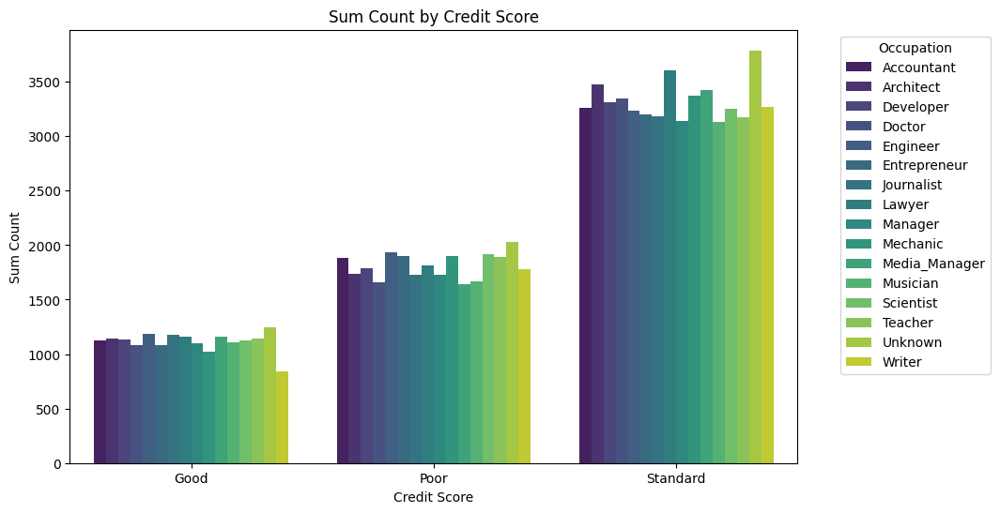

In [ ]:
def plot_sum_of_object_col_by_credit_score(col):
    sum_by_credit_score = df.groupby('Credit_Score')[col].value_counts().reset_index(name='Count')
    plt.figure(figsize=(10, 6))
    sns.barplot(x='Credit_Score', y='Count', hue=col, data=sum_by_credit_score, palette='viridis')
    plt.title(f'Sum Count by Credit Score')
    plt.xlabel('Credit Score')
    plt.ylabel(f'Sum Count')
    plt.legend(title=col, bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()

plot_sum_of_object_col_by_credit_score('Occupation')

In [ ]:
sum_by_credit_score = df.groupby('Credit_Score')['Occupation'].value_counts().reset_index()
sum_by_credit_score

,Credit_Score,Occupation,count
0,Good,Unknown,1243
1,Good,Engineer,1182
2,Good,Journalist,1173
3,Good,Lawyer,1162
4,Good,Media_Manager,1161
5,Good,Architect,1144
6,Good,Teacher,1143
7,Good,Developer,1134
8,Good,Accountant,1128
9,Good,Scientist,1127


In [ ]:
# Annual_Income

In [ ]:
df['Annual_Income'].describe()

count       100000
unique       18940
top       36585.12
freq            16
Name: Annual_Income, dtype: object

In [ ]:
df['Annual_Income'] = df['Annual_Income'].str.replace(r'[_\s-]', '', regex=True)
df['Annual_Income']=df['Annual_Income'].astype('float')

In [ ]:
df['Annual_Income'].describe()

count    1.000000e+05
mean     1.764157e+05
std      1.429618e+06
min      7.005930e+03
25%      1.945750e+04
50%      3.757861e+04
75%      7.279092e+04
max      2.419806e+07
Name: Annual_Income, dtype: float64

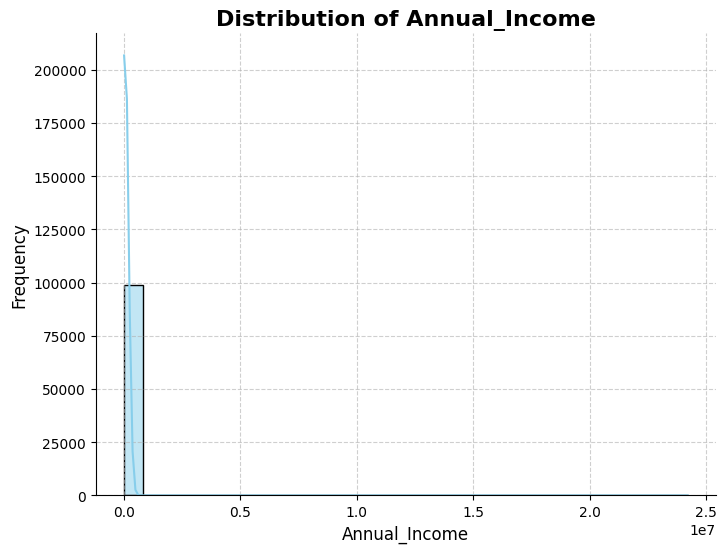

In [ ]:
plot_distribution(df,'Annual_Income')

In [ ]:
# for now we will keep them
df[df['Annual_Income'] > 500000].sort_values(by='Annual_Income')

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
50458,0x13da8,CUS_0xb798,March,Karlk,52.0,908-32-4592,Mechanic,578236.0,3798.059167,5,...,_,208.05,33.083036,NaN,No,0.000000,261.26060934021734,High_spent_Small_value_payments,378.54530732644935,Standard
50471,0x13db9,CUS_0xb450,August,Wayner,47.0,564-78-6008,Entrepreneur,580744.0,2911.420833,1,...,Good,1365.41,26.641453,25 Years and 5 Months,No,15.805627,46.42576437523685,High_spent_Medium_value_payments,478.91069242686564,Good
245,0x176f,CUS_0x9a71,June,Mukhopadhyayc,55.0,889-07-2357,Scientist,586359.0,1684.168333,1,...,Good,413.32,28.836349,18 Years and 8 Months,No,29.534584,68.95672493704708,High_spent_Medium_value_payments,319.9255246757902,Good
79379,0x1e71d,CUS_0x2b2b,April,Mennc,23.0,216-65-5815,Scientist,649977.0,1115.160000,8,...,Bad,4555.49,32.607965,13 Years and 6 Months,Yes,72.924860,112.2464402080887,Low_spent_Small_value_payments,216.34469986251557,Standard
17619,0x7d3d,CUS_0x4127,April,ars,41.0,#F%$D@*&8,Unknown,661208.0,10707.713333,5,...,Standard,386.67,42.366780,27 Years and 2 Months,Yes,80.374790,153.58199620715402,High_spent_Medium_value_payments,1086.8145468425405,Poor
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27262,0xb5bc,CUS_0x1a23,July,Paige Gancec,51.0,092-81-2077,Lawyer,24105369.0,3165.787500,3,...,Good,671.94,29.621716,31 Years and 4 Months,No,57.514937,237.62297662779355,Low_spent_Medium_value_payments,301.4408366481539,Standard
14588,0x6b7a,CUS_0x6cad,May,Mattl,38.0,#F%$D@*&8,Teacher,24160009.0,3852.982500,10,...,Bad,3148.34,25.225734,12 Years and 11 Months,Yes,196.888046,159.59397181813247,High_spent_Medium_value_payments,278.81623233206835,Standard
59059,0x1700d,CUS_0x5b6f,April,Forgionej,21.0,054-49-7239,Mechanic,24177153.0,2373.828333,4,...,Good,1443.42,39.408584,21 Years and 2 Months,No,0.000000,136.17554240661272,Low_spent_Medium_value_payments,381.20729092672065,Standard
7814,0x43c8,CUS_0xb1a0,July,Wachtelm,17.0,249-90-4145,Lawyer,24188807.0,1067.655833,8,...,_,3703.96,41.268945,10 Years and 1 Months,NM,87.323423,25.385696011834174,High_spent_Small_value_payments,254.05646414690938,Standard


In [ ]:
# here we will use the mode to avoid outlier 
df['Annual_Income']=df.groupby('Customer_ID')['Annual_Income'].transform(lambda Annual_Income: Annual_Income.mode()[0])

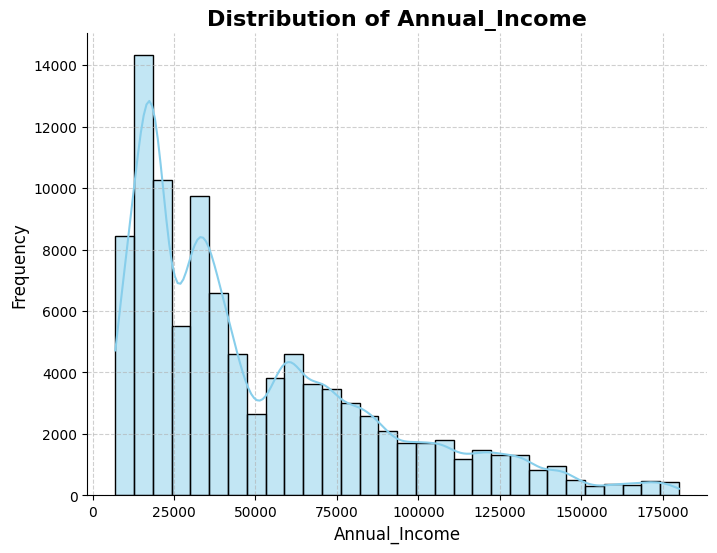

In [ ]:
plot_distribution(df,'Annual_Income')

In [ ]:
# Monthly_Inhand_Salary
df['Monthly_Inhand_Salary'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 100000 entries, 0 to 99999
Series name: Monthly_Inhand_Salary
Non-Null Count  Dtype  
--------------  -----  
84998 non-null  float64
dtypes: float64(1)
memory usage: 781.4 KB


In [ ]:
df['Monthly_Inhand_Salary'].nunique()

13235

In [ ]:
# In this case we will do the same as beore, group by customer id then we can fill the NaN using mode
df['Monthly_Inhand_Salary']=df.groupby('Customer_ID')['Monthly_Inhand_Salary'].transform(lambda Monthly_Inhand_Salary: Monthly_Inhand_Salary.mode()[0])

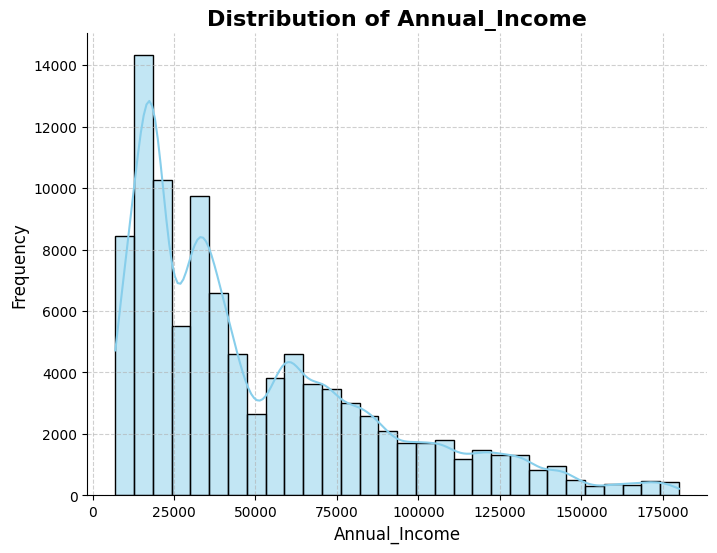

In [ ]:
plot_distribution(df,'Annual_Income')

Num_Bank_Accounts describe:
count    100000.000000
mean         17.091280
std         117.404834
min          -1.000000
25%           3.000000
50%           6.000000
75%           7.000000
max        1798.000000
Name: Num_Bank_Accounts, dtype: float64
Before using mode: 


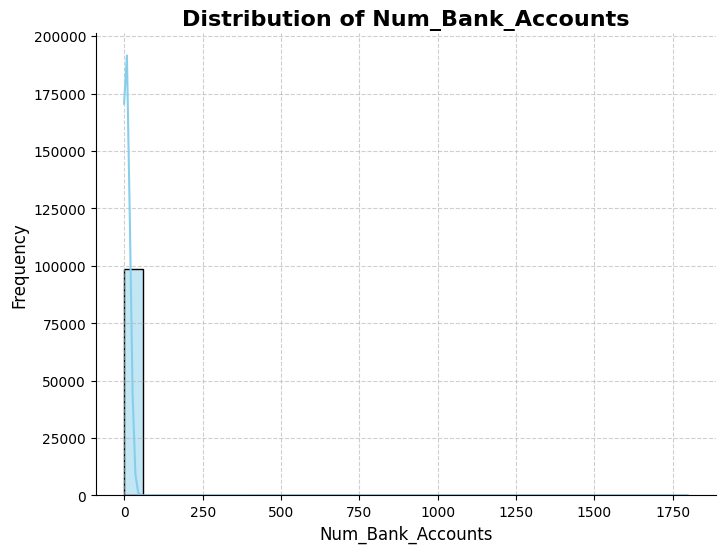

After using mode to adjust outlier: 


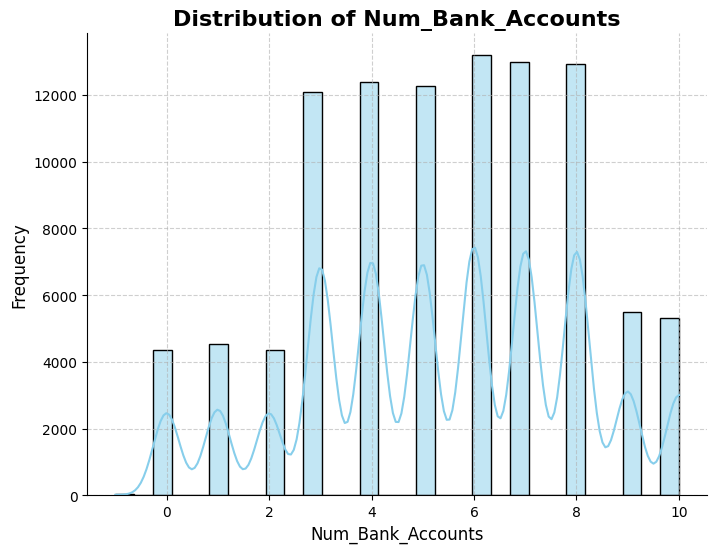

Num_Credit_Card describe:
count    100000.00000
mean         22.47443
std         129.05741
min           0.00000
25%           4.00000
50%           5.00000
75%           7.00000
max        1499.00000
Name: Num_Credit_Card, dtype: float64
Before using mode: 


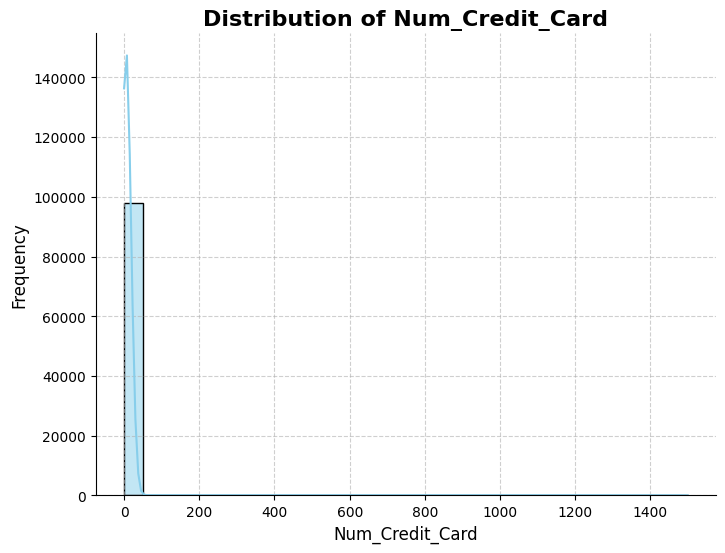

After using mode to adjust outlier: 


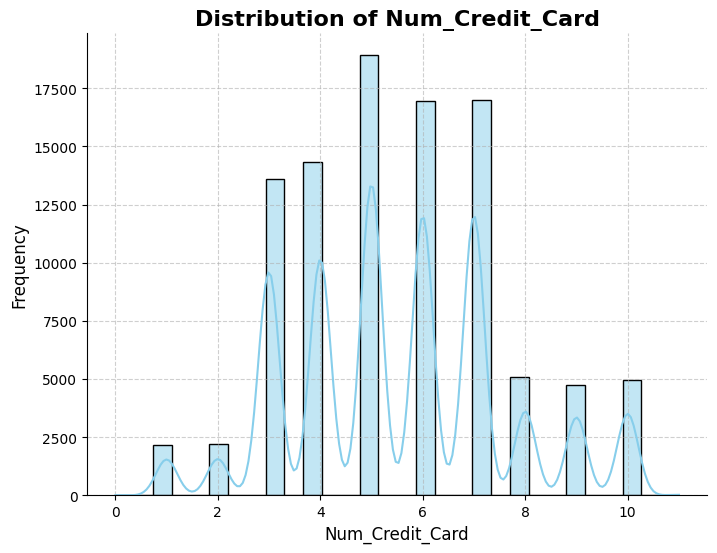

Interest_Rate describe:
count    100000.000000
mean         72.466040
std         466.422621
min           1.000000
25%           8.000000
50%          13.000000
75%          20.000000
max        5797.000000
Name: Interest_Rate, dtype: float64
Before using mode: 


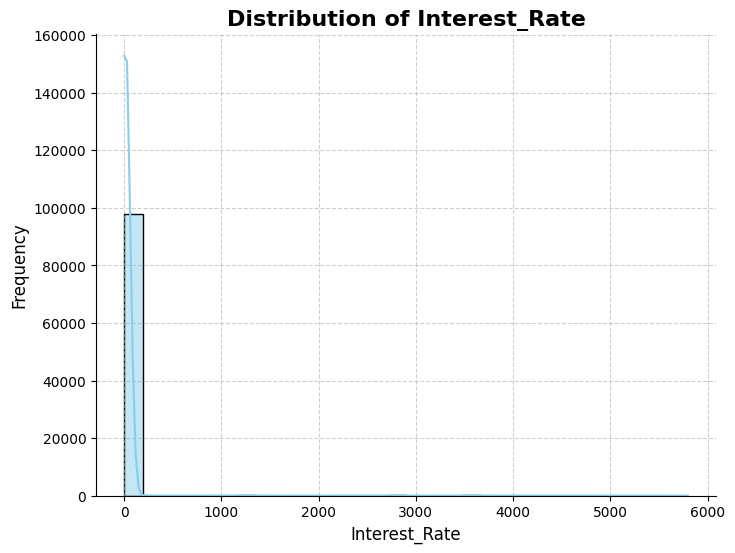

After using mode to adjust outlier: 


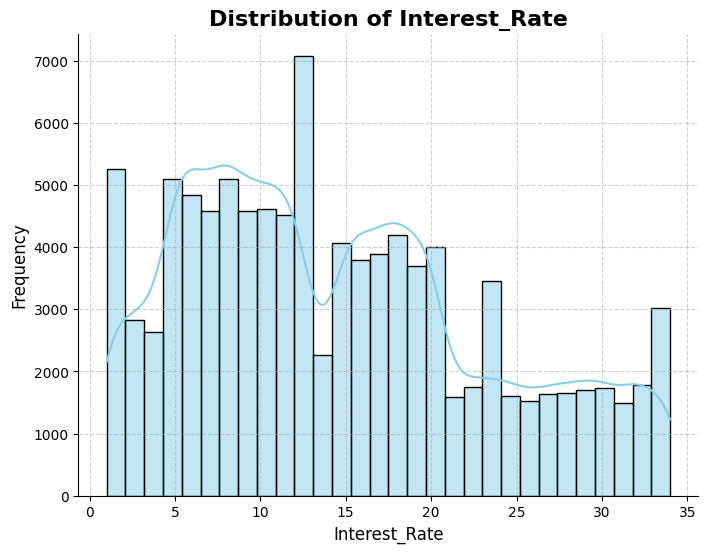

In [ ]:
# Num_Bank_Accounts, Num_Credit_Card and Interest_Rate
# We will write a funtion to analyze this 3 togther since they are same data type

def EDA_for_Int_col(col):
    print(col + ' describe:')
    print(df[col].describe())
    print("Before using mode: ")
    plot_distribution(df, col)
    df[col] = df.groupby('Customer_ID')[col].transform(lambda x: x.mode()[0])
    print("After using mode to adjust outlier: ")
    plot_distribution(df, col)

columns = ['Num_Bank_Accounts', 'Num_Credit_Card', 'Interest_Rate']
for col in columns:
    EDA_for_Int_col(col)

In [ ]:
df['Num_of_Loan'] = df['Num_of_Loan'].str.replace(r'[_\s-]', '', regex=True)
df['Num_of_Loan'] = df['Num_of_Loan'].astype('int')
df['Num_of_Loan'].describe()

count    100000.000000
mean         10.761960
std          61.789933
min           0.000000
25%           2.000000
50%           3.000000
75%           6.000000
max        1496.000000
Name: Num_of_Loan, dtype: float64

Num_of_Loan describe:
count    100000.000000
mean         10.761960
std          61.789933
min           0.000000
25%           2.000000
50%           3.000000
75%           6.000000
max        1496.000000
Name: Num_of_Loan, dtype: float64
Before using mode: 


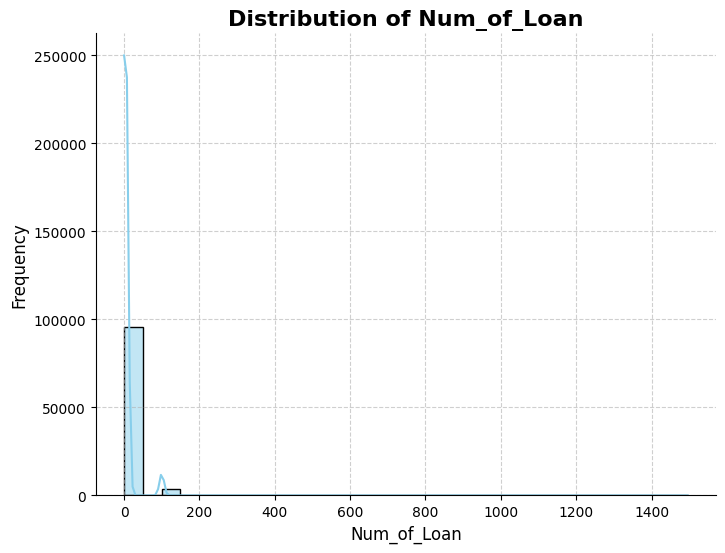

After using mode to adjust outlier: 


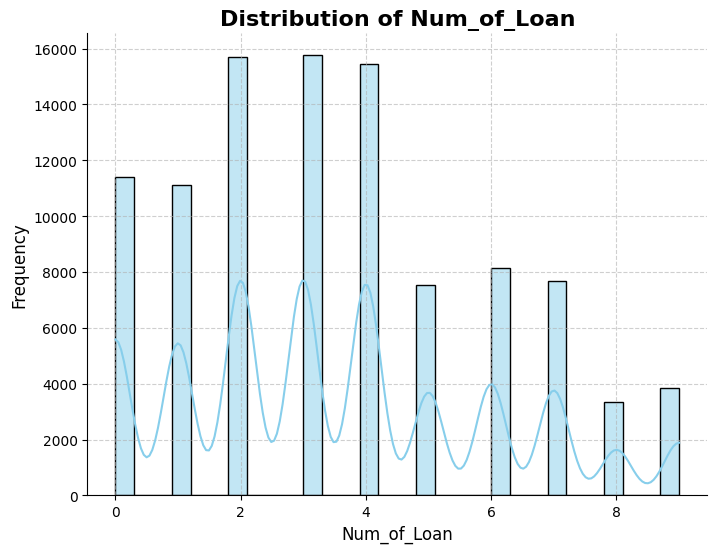

In [ ]:
# We will run the EDA_for_Int_col to get ridof outliers
EDA_for_Int_col('Num_of_Loan')

In [ ]:
df['Type_of_Loan'].unique()

array(['Auto Loan, Credit-Builder Loan, Personal Loan, and Home Equity Loan',
       'Credit-Builder Loan', 'Auto Loan, Auto Loan, and Not Specified',
       ..., 'Home Equity Loan, Auto Loan, Auto Loan, and Auto Loan',
       'Payday Loan, Student Loan, Mortgage Loan, and Not Specified',
       'Personal Loan, Auto Loan, Mortgage Loan, Student Loan, and Student Loan'],
      dtype=object)

In [ ]:
df['Type_of_Loan'] = df['Type_of_Loan'].str.replace('and ', '')
df['Type_of_Loan'] = df.groupby('Customer_ID')['Type_of_Loan'].fillna(lambda v: v.mode()[0])

In [ ]:
# Delay_from_due_date
print(df['Delay_from_due_date'].describe())
print(df['Delay_from_due_date'].unique())

count    100000.000000
mean         21.068780
std          14.860104
min          -5.000000
25%          10.000000
50%          18.000000
75%          28.000000
max          67.000000
Name: Delay_from_due_date, dtype: float64
[ 3 -1  5  6  8  7 13 10  0  4  9  1 12 11 30 31 34 27 14  2 -2 16 17 15
 23 22 21 18 19 52 51 48 53 26 43 28 25 20 47 46 49 24 61 29 50 58 45 59
 55 56 57 54 62 65 64 67 36 41 33 32 39 44 42 60 35 38 -3 63 40 37 -5 -4
 66]


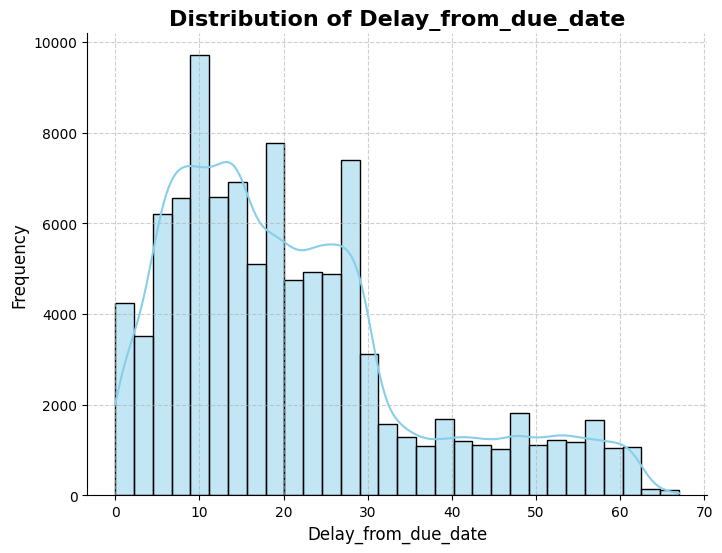

In [ ]:
df['Delay_from_due_date'] = df['Delay_from_due_date'].apply(lambda x: np.nan if x<0 else x)
df['Delay_from_due_date'] = df['Delay_from_due_date'].ffill(axis=0) # using forward fill instate of mode
plot_distribution(df,'Delay_from_due_date')

In [ ]:
# Num_of_Delayed_Payment
df['Num_of_Delayed_Payment'].describe()

count     92998
unique      749
top          19
freq       5327
Name: Num_of_Delayed_Payment, dtype: object

In [ ]:
df['Num_of_Delayed_Payment'] = df['Num_of_Delayed_Payment'].str.replace(r'[_\s-]', '', regex=True)
df['Num_of_Delayed_Payment'] = df['Num_of_Delayed_Payment'].astype('float')

Num_of_Delayed_Payment describe:
count    92998.000000
mean        30.946268
std        226.028754
min          0.000000
25%          9.000000
50%         14.000000
75%         18.000000
max       4397.000000
Name: Num_of_Delayed_Payment, dtype: float64
Before using mode: 


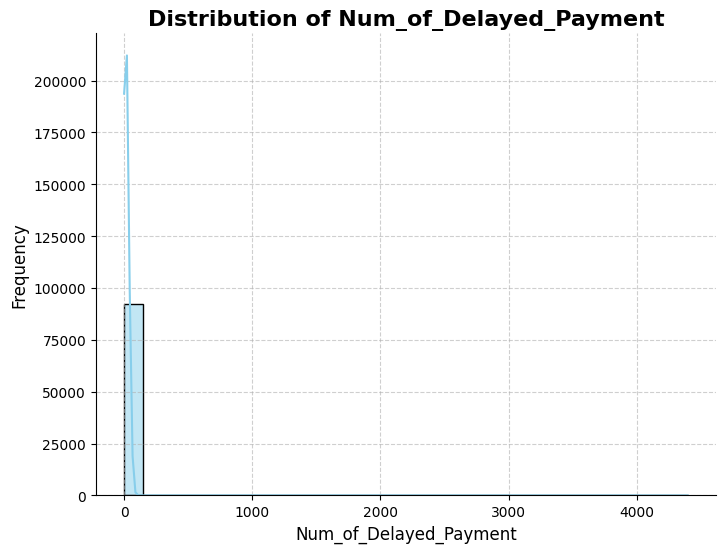

After using mode to adjust outlier: 


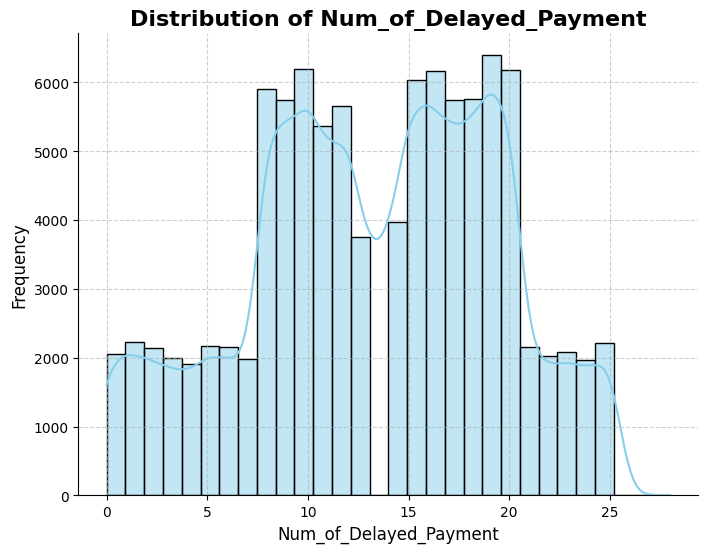

In [ ]:
EDA_for_Int_col('Num_of_Delayed_Payment')

In [ ]:
df['Changed_Credit_Limit'] = df['Changed_Credit_Limit'].apply(lambda x: np.NaN if x=='_' else x).astype('float64')
df['Changed_Credit_Limit'] = df['Changed_Credit_Limit'].ffill(axis=0)

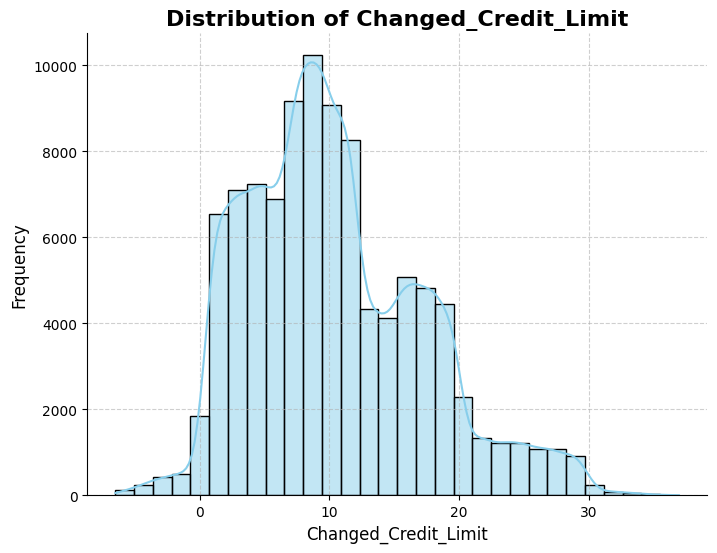

In [ ]:
# Changed_Credit_Limit is in %
plot_distribution(df,'Changed_Credit_Limit')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype   
---  ------                    --------------   -----   
 0   ID                        100000 non-null  object  
 1   Customer_ID               100000 non-null  object  
 2   Month                     100000 non-null  object  
 3   Name                      100000 non-null  category
 4   Age                       100000 non-null  float64 
 5   SSN                       100000 non-null  object  
 6   Occupation                100000 non-null  category
 7   Annual_Income             100000 non-null  float64 
 8   Monthly_Inhand_Salary     100000 non-null  float64 
 9   Num_Bank_Accounts         100000 non-null  int64   
 10  Num_Credit_Card           100000 non-null  int64   
 11  Interest_Rate             100000 non-null  int64   
 12  Num_of_Loan               100000 non-null  int64   
 13  Type_of_Loan              1000

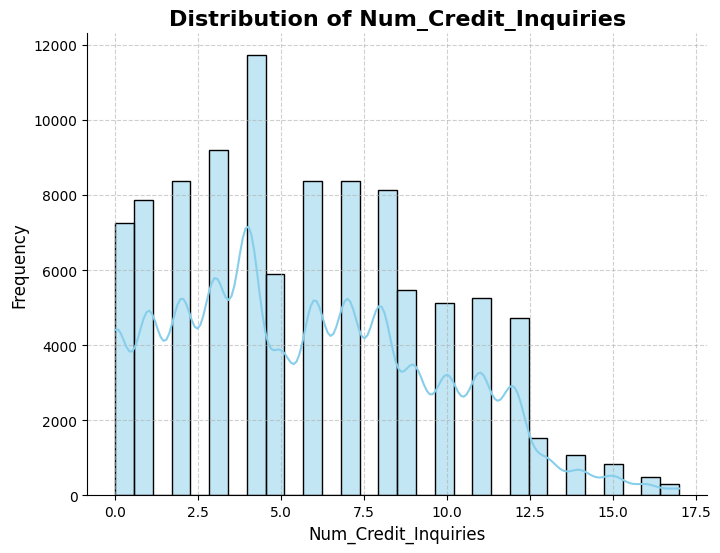

In [ ]:
df['Num_Credit_Inquiries'] = df['Num_Credit_Inquiries'].apply(lambda x: np.NaN if x<0 or x>20 else x)
df['Num_Credit_Inquiries'] = df['Num_Credit_Inquiries'].ffill(axis=0)
plot_distribution(df,'Num_Credit_Inquiries')

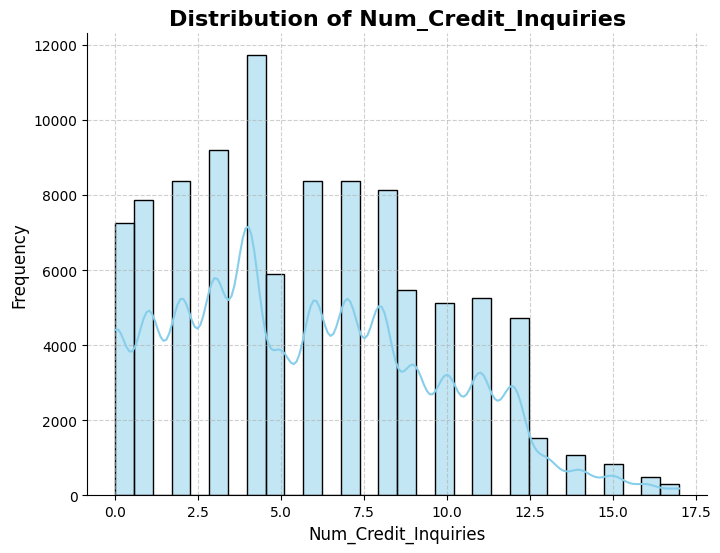

In [ ]:
df['Num_Credit_Inquiries'] = df['Num_Credit_Inquiries'].apply(lambda x: np.NaN if x<0 or x>20 else x)
df['Num_Credit_Inquiries'] = df['Num_Credit_Inquiries'].ffill(axis=0)
plot_distribution(df,'Num_Credit_Inquiries')

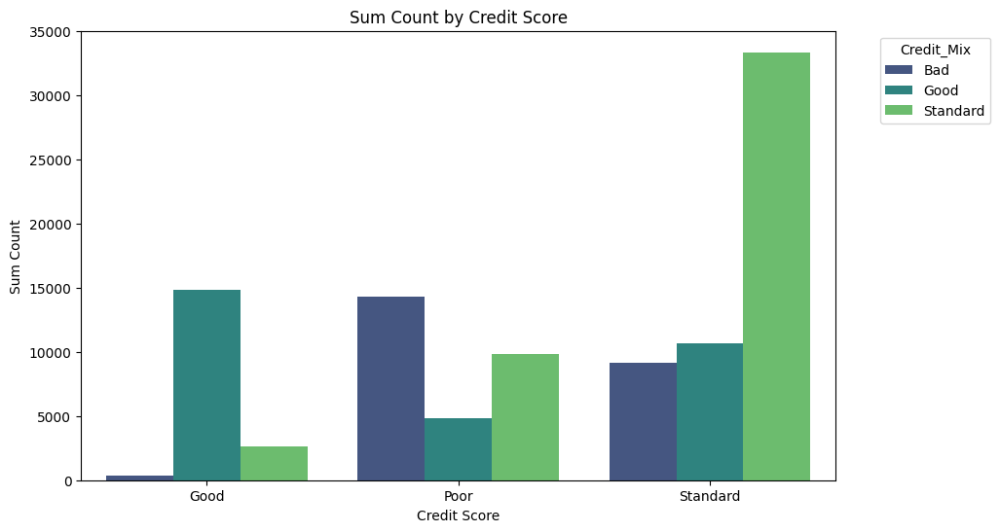

In [ ]:
df['Credit_Mix'] = (df['Credit_Mix'].apply(lambda x: np.NaN if x=='_' else x))
df['Credit_Mix'] = df.groupby('Customer_ID')['Credit_Mix'].transform(lambda v: v.mode()[0]).astype("category")
plot_sum_of_object_col_by_credit_score('Credit_Mix')

In [ ]:
# Outstanding_Debt
df['Outstanding_Debt'] = df['Outstanding_Debt'].str.replace('_', '').astype('float64')

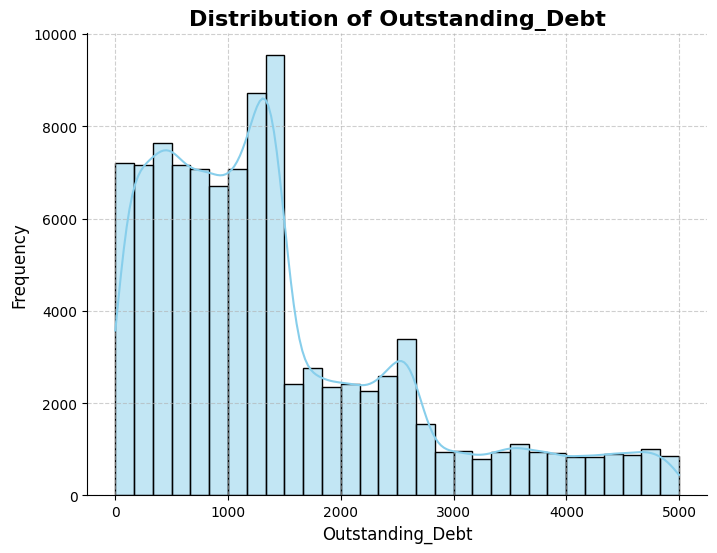

In [ ]:
plot_distribution(df,'Outstanding_Debt')

In [ ]:
# Credit_History_Age
df['Credit_History_Age']

0         22 Years and 1 Months
1                           NaN
2         22 Years and 3 Months
3         22 Years and 4 Months
4         22 Years and 5 Months
                  ...          
99995     31 Years and 6 Months
99996     31 Years and 7 Months
99997     31 Years and 8 Months
99998     31 Years and 9 Months
99999    31 Years and 10 Months
Name: Credit_History_Age, Length: 100000, dtype: object

In [ ]:
# Covert to months from year and month
def Month_Converter(x):
    if pd.notnull(x):
        num1 = int(x.split(' ')[0])
        num2 = int(x.split(' ')[3])
        return (num1*12)+num2
    else:
        return x

In [ ]:
df['Credit_History_Age'] = df.groupby('Customer_ID', group_keys=False)['Credit_History_Age'].apply(lambda x: x.interpolate().bfill().ffill())
df['Credit_History_Age'] = df.Credit_History_Age.apply(lambda x: Month_Converter(x)).astype(float)

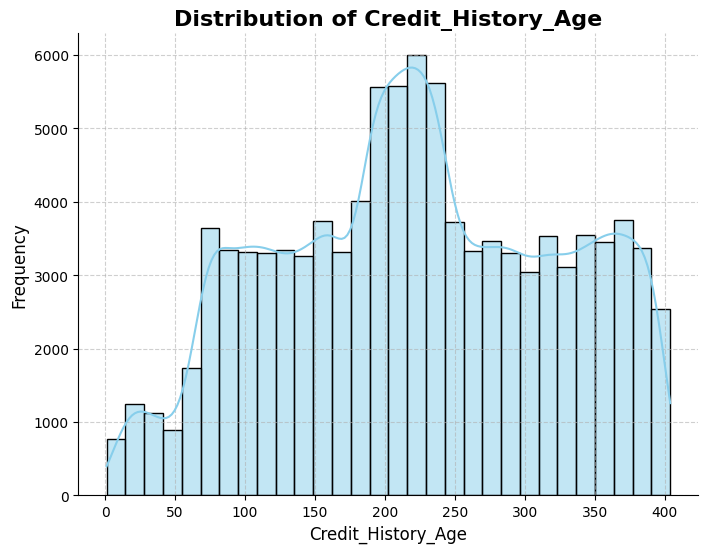

In [ ]:
plot_distribution(df,'Credit_History_Age')

In [ ]:
df['Payment_of_Min_Amount'].unique()

array(['No', 'NM', 'Yes'], dtype=object)

In [ ]:
df.groupby('Payment_of_Min_Amount').count()

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
Payment_of_Min_Amount,,,,,,,,,,,,,,,,,,,,,
NM,12007,12007,12007,12007,12007,12007,12007,12007,12007,12007,...,12007,12007,12007,12007,12007,12007,11471,12007,11856,12007
No,35667,35667,35667,35667,35667,35667,35667,35667,35667,35667,...,35667,35667,35667,35667,35667,35667,34043,35667,35326,35667
Yes,52326,52326,52326,52326,52326,52326,52326,52326,52326,52326,...,52326,52326,52326,52326,52326,52326,50007,52326,51618,52326


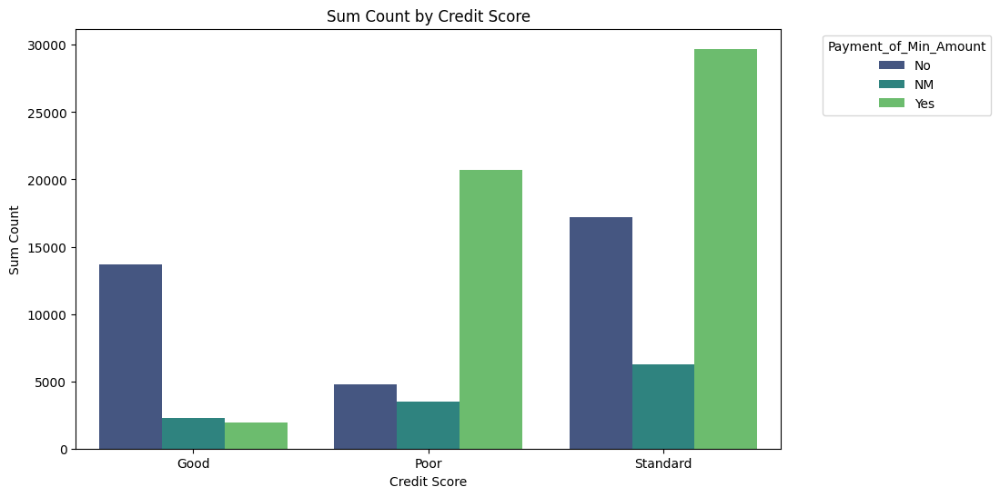

In [ ]:
plot_sum_of_object_col_by_credit_score('Payment_of_Min_Amount')

We can see poor credit score people trent to make more min payment

We will consider NM as No too, NM means no minimum payment due for them

In [ ]:
df['Payment_of_Min_Amount'] = df['Payment_of_Min_Amount'].str.replace('NM', 'No').astype("category")

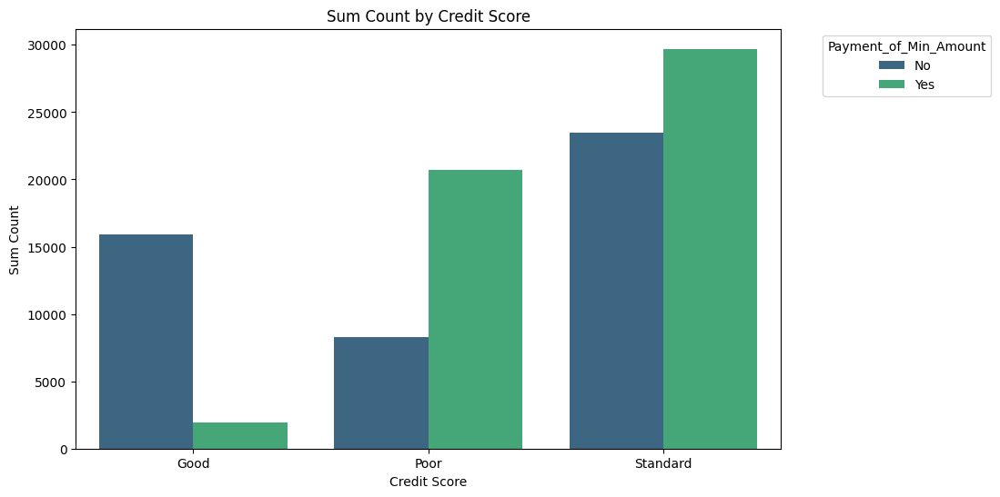

In [ ]:
plot_sum_of_object_col_by_credit_score('Payment_of_Min_Amount')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype   
---  ------                    --------------   -----   
 0   ID                        100000 non-null  object  
 1   Customer_ID               100000 non-null  object  
 2   Month                     100000 non-null  object  
 3   Name                      100000 non-null  category
 4   Age                       100000 non-null  float64 
 5   SSN                       100000 non-null  object  
 6   Occupation                100000 non-null  category
 7   Annual_Income             100000 non-null  float64 
 8   Monthly_Inhand_Salary     100000 non-null  float64 
 9   Num_Bank_Accounts         100000 non-null  int64   
 10  Num_Credit_Card           100000 non-null  int64   
 11  Interest_Rate             100000 non-null  int64   
 12  Num_of_Loan               100000 non-null  int64   
 13  Type_of_Loan              1000

In [ ]:
# Amount_invested_monthly
df['Amount_invested_monthly']

0         80.41529543900253
1        118.28022162236736
2           81.699521264648
3         199.4580743910713
4        41.420153086217326
                ...        
99995     60.97133255718485
99996     54.18595028760385
99997     24.02847744864441
99998    251.67258219721603
99999     167.1638651610451
Name: Amount_invested_monthly, Length: 100000, dtype: object

In [ ]:
df['Amount_invested_monthly'] = df['Amount_invested_monthly'].apply(
        lambda x: np.NaN if x=='__10000__' else x).astype('float64')
df['Amount_invested_monthly'] = df['Amount_invested_monthly'].fillna(
        df.groupby('Customer_ID')['Amount_invested_monthly'].transform('mean'))


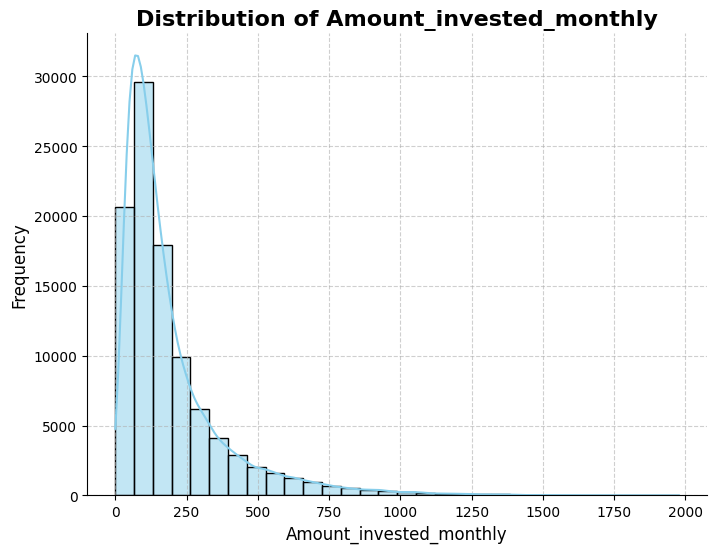

In [ ]:
plot_distribution(df,'Amount_invested_monthly')

In [ ]:
# Payment_Behaviour

df['Payment_Behaviour'] = (
    df['Payment_Behaviour'].apply(
        lambda x: np.NaN if x=='!@9#%8' else x)
)


df['Payment_Behaviour'] = (
    df.groupby('Customer_ID')['Payment_Behaviour'].transform(
        lambda v: v.mode()[0]).astype("category")
)

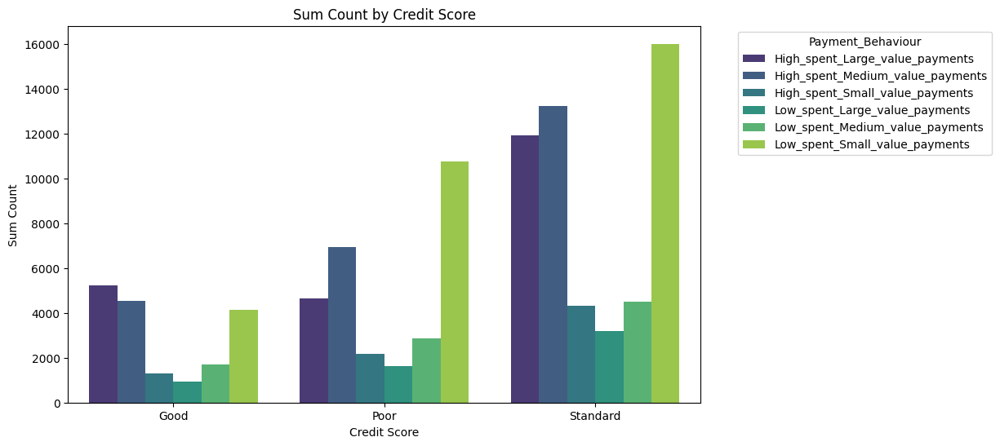

In [ ]:
plot_sum_of_object_col_by_credit_score('Payment_Behaviour')

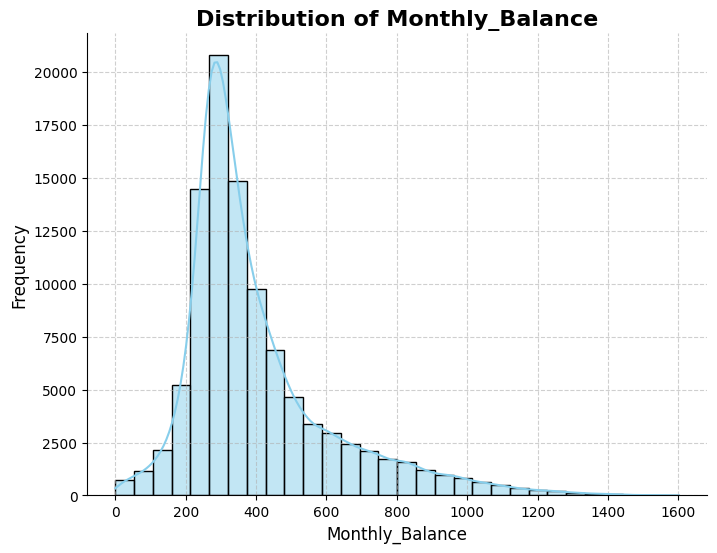

In [ ]:
df['Monthly_Balance'] = (
    df['Monthly_Balance'].apply(
        lambda x: np.NaN if x=='__-333333333333333333333333333__' else x).astype('float64')
)

df['Monthly_Balance'] = (
    df['Monthly_Balance'].fillna(
        df.groupby('Customer_ID')['Monthly_Balance'].transform('mean'))
)
plot_distribution(df,'Monthly_Balance')

In [ ]:
df['Credit_Score'] = (
    df['Credit_Score'].astype("category")
)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype   
---  ------                    --------------   -----   
 0   ID                        100000 non-null  object  
 1   Customer_ID               100000 non-null  object  
 2   Month                     100000 non-null  object  
 3   Name                      100000 non-null  category
 4   Age                       100000 non-null  float64 
 5   SSN                       100000 non-null  object  
 6   Occupation                100000 non-null  category
 7   Annual_Income             100000 non-null  float64 
 8   Monthly_Inhand_Salary     100000 non-null  float64 
 9   Num_Bank_Accounts         100000 non-null  int64   
 10  Num_Credit_Card           100000 non-null  int64   
 11  Interest_Rate             100000 non-null  int64   
 12  Num_of_Loan               100000 non-null  int64   
 13  Type_of_Loan              1000

In [ ]:
sub_df = df.drop(columns=['ID','Customer_ID','Month','Name','SSN','Age','Month','Occupation','Interest_Rate'])

In [ ]:
sub_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 20 columns):
 #   Column                    Non-Null Count   Dtype   
---  ------                    --------------   -----   
 0   Annual_Income             100000 non-null  float64 
 1   Monthly_Inhand_Salary     100000 non-null  float64 
 2   Num_Bank_Accounts         100000 non-null  int64   
 3   Num_Credit_Card           100000 non-null  int64   
 4   Num_of_Loan               100000 non-null  int64   
 5   Type_of_Loan              100000 non-null  object  
 6   Delay_from_due_date       100000 non-null  float64 
 7   Num_of_Delayed_Payment    100000 non-null  float64 
 8   Changed_Credit_Limit      100000 non-null  float64 
 9   Num_Credit_Inquiries      100000 non-null  float64 
 10  Credit_Mix                100000 non-null  category
 11  Outstanding_Debt          100000 non-null  float64 
 12  Credit_Utilization_Ratio  100000 non-null  float64 
 13  Credit_History_Age        1000

In [ ]:
sub_df.T

,0,1,2,3,4,5,6,7,8,9,...,99990,99991,99992,99993,99994,99995,99996,99997,99998,99999
Annual_Income,19114.12,19114.12,19114.12,19114.12,19114.12,19114.12,19114.12,19114.12,34847.84,34847.84,...,20002.88,20002.88,39628.99,39628.99,39628.99,39628.99,39628.99,39628.99,39628.99,39628.99
Monthly_Inhand_Salary,1824.843333,1824.843333,1824.843333,1824.843333,1824.843333,1824.843333,1824.843333,1824.843333,3037.986667,3037.986667,...,1929.906667,1929.906667,3359.415833,3359.415833,3359.415833,3359.415833,3359.415833,3359.415833,3359.415833,3359.415833
Num_Bank_Accounts,3,3,3,3,3,3,3,3,2,2,...,10,10,4,4,4,4,4,4,4,4
Num_Credit_Card,4,4,4,4,4,4,4,4,4,4,...,8,8,6,6,6,6,6,6,6,6
Num_of_Loan,4,4,4,4,4,4,4,4,1,1,...,5,5,2,2,2,2,2,2,2,2
Type_of_Loan,"Auto Loan, Credit-Builder Loan, Personal Loan,...","Auto Loan, Credit-Builder Loan, Personal Loan,...","Auto Loan, Credit-Builder Loan, Personal Loan,...","Auto Loan, Credit-Builder Loan, Personal Loan,...","Auto Loan, Credit-Builder Loan, Personal Loan,...","Auto Loan, Credit-Builder Loan, Personal Loan,...","Auto Loan, Credit-Builder Loan, Personal Loan,...","Auto Loan, Credit-Builder Loan, Personal Loan,...",Credit-Builder Loan,Credit-Builder Loan,...,"Personal Loan, Auto Loan, Mortgage Loan, Stude...","Personal Loan, Auto Loan, Mortgage Loan, Stude...","Auto Loan, Student Loan","Auto Loan, Student Loan","Auto Loan, Student Loan","Auto Loan, Student Loan","Auto Loan, Student Loan","Auto Loan, Student Loan","Auto Loan, Student Loan","Auto Loan, Student Loan"
Delay_from_due_date,3.0,3.0,3.0,5.0,6.0,8.0,3.0,3.0,3.0,7.0,...,33.0,33.0,23.0,23.0,20.0,23.0,18.0,27.0,20.0,18.0
Num_of_Delayed_Payment,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,1.0,1.0,...,25.0,25.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0
Changed_Credit_Limit,11.27,11.27,11.27,6.27,11.27,9.27,11.27,11.27,5.42,7.42,...,18.31,18.31,9.5,11.5,9.5,11.5,11.5,11.5,11.5,11.5
Num_Credit_Inquiries,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,2.0,2.0,...,9.0,9.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0


In [ ]:
sub_df.corr(numeric_only=True)

,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance
Annual_Income,1.000000,0.998158,-0.284101,-0.217863,-0.255560,-0.249631,-0.290600,-0.174620,-0.279013,-0.269319,0.175930,0.272360,0.008328,0.635237,0.704362
Monthly_Inhand_Salary,0.998158,1.000000,-0.283060,-0.217006,-0.254316,-0.248931,-0.289522,-0.174529,-0.278230,-0.269037,0.176105,0.271441,0.007821,0.635883,0.705434
Num_Bank_Accounts,-0.284101,-0.283060,1.000000,0.442292,0.472474,0.558568,0.612361,0.330103,0.516168,0.506988,-0.071875,-0.485204,-0.006335,-0.184399,-0.300797
Num_Credit_Card,-0.217863,-0.217006,0.442292,1.000000,0.417835,0.478365,0.430402,0.252216,0.457626,0.490266,-0.055353,-0.416936,-0.006683,-0.144642,-0.238869
Num_of_Loan,-0.255560,-0.254316,0.472474,0.417835,1.000000,0.500710,0.481911,0.368850,0.563707,0.638713,-0.100469,-0.605723,-0.001266,-0.166538,-0.435084
Delay_from_due_date,-0.249631,-0.248931,0.558568,0.478365,0.500710,1.000000,0.550174,0.292004,0.536890,0.571341,-0.063693,-0.490781,-0.003781,-0.164052,-0.281587
Num_of_Delayed_Payment,-0.290600,-0.289522,0.612361,0.430402,0.481911,0.550174,1.000000,0.331637,0.507071,0.513262,-0.075553,-0.490463,-0.005330,-0.187281,-0.310367
Changed_Credit_Limit,-0.174620,-0.174529,0.330103,0.252216,0.368850,0.292004,0.331637,1.000000,0.377046,0.457291,-0.047962,-0.423709,-0.002150,-0.115973,-0.204772
Num_Credit_Inquiries,-0.279013,-0.278230,0.516168,0.457626,0.563707,0.536890,0.507071,0.377046,1.000000,0.595284,-0.076790,-0.607858,-0.004670,-0.177821,-0.320882
Outstanding_Debt,-0.269319,-0.269037,0.506988,0.490266,0.638713,0.571341,0.513262,0.457291,0.595284,1.000000,-0.071165,-0.629325,-0.004856,-0.175870,-0.317648


<Axes: xlabel='Credit_Score', ylabel='Annual_Income'>

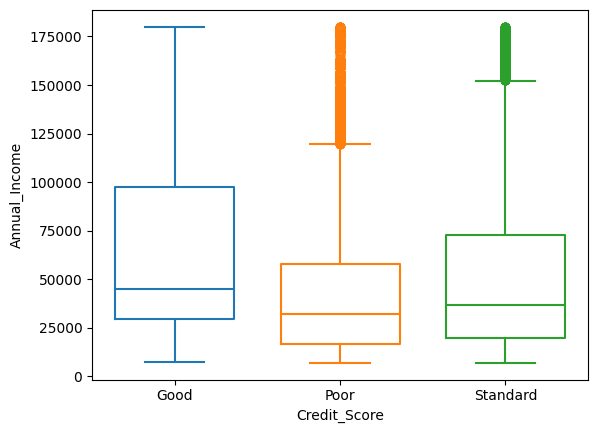

In [ ]:
sns.boxplot(data=sub_df, x="Credit_Score", y="Annual_Income", hue="Credit_Score", fill=False, gap=.1)

In [ ]:
fig_prestamo = px.violin(
    sub_df, 
    x='Num_of_Loan', 
    y='Credit_Score',
    color='Credit_Score', 
    color_discrete_sequence=px.colors.qualitative.Vivid,
    width=800, height=400, 
    title='Num_of_Loan vs Credit_Score'
)

fig_prestamo.update_layout(showlegend=False)
fig_prestamo.show()

In [ ]:
fig_prestamo1 = px.violin(
    df, 
    x='Outstanding_Debt', 
    y='Credit_Score',
    color='Credit_Score', 
    box=True,
    color_discrete_sequence=px.colors.qualitative.Vivid,
    width=800, height=400, 
    title='Outstanding_Debt vs Credit_Score'
)

fig_prestamo1.update_layout(showlegend=False)
fig_prestamo1.show()

In [ ]:
Credit_Utilization_Ratio_VS_Credit_Score = px.box(
    df,
    x='Credit_Utilization_Ratio',
    y='Credit_Score',
    color='Credit_Score',
    color_discrete_sequence=px.colors.qualitative.Vivid,
    width=800, height=400,
    title='Credit_Utilization_Ratio_VS_Credit_Score'
)
Credit_Utilization_Ratio_VS_Credit_Score.show()

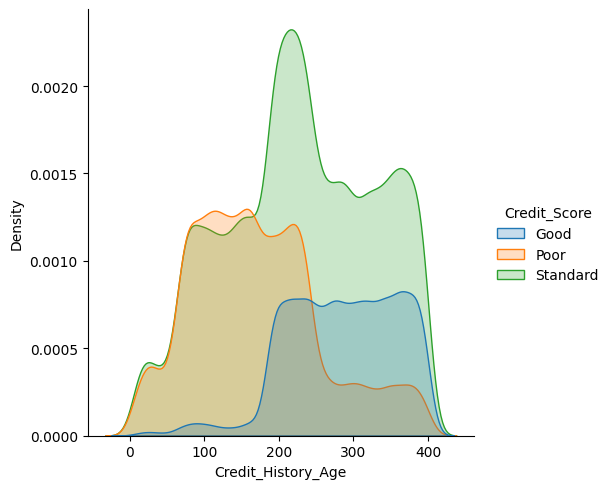

In [ ]:
sns.displot(
    sub_df, 
    x='Credit_History_Age',
    hue='Credit_Score', 
    kind='kde', 
    fill=True)

plt.show()

In [ ]:
sub_df.describe()

,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance
count,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.00000,100000.000000,100000.000000,100000.000000
mean,50505.123449,4197.328114,5.367520,5.532720,3.532880,21.108440,13.266640,10.389784,5.780270,1426.220376,32.285173,221.27786,1403.118217,195.751837,403.120320
std,38299.422093,3186.918569,2.593321,2.067504,2.446356,14.822424,6.194986,6.790119,3.862931,1155.129026,5.116875,99.67973,8306.041270,195.116198,214.014558
min,7005.930000,303.645417,-1.000000,0.000000,0.000000,0.000000,0.000000,-6.490000,0.000000,0.230000,20.000000,1.00000,0.000000,0.000000,0.007760
25%,19342.972500,1626.719792,3.000000,4.000000,2.000000,10.000000,9.000000,5.330000,3.000000,566.072500,28.052567,145.00000,30.306660,74.599540,270.189030
50%,36999.705000,3092.270000,5.000000,5.000000,3.000000,18.000000,14.000000,9.400000,5.000000,1166.155000,32.305784,220.00000,69.249473,131.209101,337.114461
75%,71683.470000,5958.695625,7.000000,7.000000,5.000000,28.000000,18.000000,14.860000,8.000000,1945.962500,36.496663,302.00000,161.224249,239.479981,471.570652
max,179987.280000,15204.633333,10.000000,11.000000,9.000000,67.000000,28.000000,36.970000,17.000000,4998.070000,50.000000,404.00000,82331.000000,1977.326102,1602.040519


In [ ]:
sub_df.describe(exclude = np.number)

,Type_of_Loan,Credit_Mix,Payment_of_Min_Amount,Payment_Behaviour,Credit_Score
count,100000,100000,100000,100000,100000
unique,6261,3,2,6,3
top,<function <lambda> at 0x7f70381d4a60>,Standard,Yes,Low_spent_Small_value_payments,Standard
freq,11408,45848,52326,30880,53174


In [ ]:
sub_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 20 columns):
 #   Column                    Non-Null Count   Dtype   
---  ------                    --------------   -----   
 0   Annual_Income             100000 non-null  float64 
 1   Monthly_Inhand_Salary     100000 non-null  float64 
 2   Num_Bank_Accounts         100000 non-null  int64   
 3   Num_Credit_Card           100000 non-null  int64   
 4   Num_of_Loan               100000 non-null  int64   
 5   Type_of_Loan              100000 non-null  object  
 6   Delay_from_due_date       100000 non-null  float64 
 7   Num_of_Delayed_Payment    100000 non-null  float64 
 8   Changed_Credit_Limit      100000 non-null  float64 
 9   Num_Credit_Inquiries      100000 non-null  float64 
 10  Credit_Mix                100000 non-null  category
 11  Outstanding_Debt          100000 non-null  float64 
 12  Credit_Utilization_Ratio  100000 non-null  float64 
 13  Credit_History_Age        1000

In [ ]:
sub_df['Type_of_Loan'].unique()

array(['Auto Loan, Credit-Builder Loan, Personal Loan, Home Equity Loan',
       'Credit-Builder Loan', 'Auto Loan, Auto Loan, Not Specified', ...,
       'Home Equity Loan, Auto Loan, Auto Loan, Auto Loan',
       'Payday Loan, Student Loan, Mortgage Loan, Not Specified',
       'Personal Loan, Auto Loan, Mortgage Loan, Student Loan, Student Loan'],
      dtype=object)

In [ ]:
sub_df_dummies = sub_df['Type_of_Loan'].str.get_dummies(sep=', ')
sub_df = sub_df.drop(columns='Type_of_Loan')
sub_df = pd.concat([sub_df, sub_df_dummies], axis=1)

In [ ]:
sub_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 29 columns):
 #   Column                                 Non-Null Count   Dtype   
---  ------                                 --------------   -----   
 0   Annual_Income                          100000 non-null  float64 
 1   Monthly_Inhand_Salary                  100000 non-null  float64 
 2   Num_Bank_Accounts                      100000 non-null  int64   
 3   Num_Credit_Card                        100000 non-null  int64   
 4   Num_of_Loan                            100000 non-null  int64   
 5   Delay_from_due_date                    100000 non-null  float64 
 6   Num_of_Delayed_Payment                 100000 non-null  float64 
 7   Changed_Credit_Limit                   100000 non-null  float64 
 8   Num_Credit_Inquiries                   100000 non-null  float64 
 9   Credit_Mix                             100000 non-null  category
 10  Outstanding_Debt                       100000

For Credit_Mix, Payment_Behaviour, Credit_Score we will be using label encoding

In [ ]:
lables = {
    'Bad' : 0,
    'Standard' : 1,
    'Good' : 2,
    }

sub_df['Credit_Mix'] = sub_df['Credit_Mix'].map(lables)
sub_df['Credit_Mix'] = sub_df['Credit_Mix'].astype("int64")

In [ ]:
lables = {
    'Low_spent_Small_value_payments' : 0,
    'Low_spent_Medium_value_payments' : 1,
    'Low_spent_Large_value_payments' : 2,
    'High_spent_Small_value_payments' : 3,
    'High_spent_Medium_value_payments' : 4,
    'High_spent_Large_value_payments' : 5
    }

sub_df['Payment_Behaviour'] = sub_df['Payment_Behaviour'].map(lables)
sub_df['Payment_Behaviour'] = sub_df['Payment_Behaviour'].astype("int64")

In [ ]:
from sklearn.preprocessing import LabelEncoder
LE = LabelEncoder()

In [ ]:
sub_df['Credit_Score']= LE.fit_transform(sub_df['Credit_Score'])

In [ ]:
sub_df = pd.get_dummies(sub_df,dtype='int')

In [ ]:
sub_df.T

,0,1,2,3,4,5,6,7,8,9,...,99990,99991,99992,99993,99994,99995,99996,99997,99998,99999
Annual_Income,19114.120000,19114.120000,19114.120000,19114.120000,19114.120000,19114.120000,19114.120000,19114.120000,34847.840000,34847.840000,...,20002.880000,20002.880000,39628.990000,39628.990000,39628.990000,39628.990000,39628.990000,39628.990000,39628.990000,39628.990000
Monthly_Inhand_Salary,1824.843333,1824.843333,1824.843333,1824.843333,1824.843333,1824.843333,1824.843333,1824.843333,3037.986667,3037.986667,...,1929.906667,1929.906667,3359.415833,3359.415833,3359.415833,3359.415833,3359.415833,3359.415833,3359.415833,3359.415833
Num_Bank_Accounts,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,2.000000,2.000000,...,10.000000,10.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000
Num_Credit_Card,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,...,8.000000,8.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000
Num_of_Loan,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,1.000000,1.000000,...,5.000000,5.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000
Delay_from_due_date,3.000000,3.000000,3.000000,5.000000,6.000000,8.000000,3.000000,3.000000,3.000000,7.000000,...,33.000000,33.000000,23.000000,23.000000,20.000000,23.000000,18.000000,27.000000,20.000000,18.000000
Num_of_Delayed_Payment,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,1.000000,1.000000,...,25.000000,25.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000,6.000000
Changed_Credit_Limit,11.270000,11.270000,11.270000,6.270000,11.270000,9.270000,11.270000,11.270000,5.420000,7.420000,...,18.310000,18.310000,9.500000,11.500000,9.500000,11.500000,11.500000,11.500000,11.500000,11.500000
Num_Credit_Inquiries,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,2.000000,2.000000,...,9.000000,9.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000
Credit_Mix,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,...,0.000000,0.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000


In [ ]:
# Normalizing
from sklearn.preprocessing import RobustScaler
import pandas as pd

# Define the numerical columns to be scaled
numerical_columns = ['Annual_Income',
                     'Monthly_Inhand_Salary',
                     'Num_Bank_Accounts',
                     'Num_Credit_Card',
                     'Num_of_Loan',
                     'Delay_from_due_date',
                     'Num_of_Delayed_Payment',
                     'Changed_Credit_Limit',
                     'Num_Credit_Inquiries',
                     'Outstanding_Debt',
                     'Credit_Utilization_Ratio',
                     'Credit_History_Age',
                     'Total_EMI_per_month',
                     'Amount_invested_monthly',
                     'Monthly_Balance']

# Extract the numerical variables
numerical_variables = sub_df[numerical_columns]

# Initialize RobustScaler
rs = RobustScaler()

# Fit and transform the numerical variables
numerical_variables_rs = rs.fit_transform(numerical_variables)

# Create a DataFrame with scaled values
subdf_rs = pd.DataFrame(numerical_variables_rs, columns=numerical_columns)

# Replace the original columns in sub_df with the scaled values
sub_df[numerical_columns] = subdf_rs

# Print info about sub_df after replacing columns
print(sub_df.info())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 30 columns):
 #   Column                                 Non-Null Count   Dtype  
---  ------                                 --------------   -----  
 0   Annual_Income                          100000 non-null  float64
 1   Monthly_Inhand_Salary                  100000 non-null  float64
 2   Num_Bank_Accounts                      100000 non-null  float64
 3   Num_Credit_Card                        100000 non-null  float64
 4   Num_of_Loan                            100000 non-null  float64
 5   Delay_from_due_date                    100000 non-null  float64
 6   Num_of_Delayed_Payment                 100000 non-null  float64
 7   Changed_Credit_Limit                   100000 non-null  float64
 8   Num_Credit_Inquiries                   100000 non-null  float64
 9   Credit_Mix                             100000 non-null  int64  
 10  Outstanding_Debt                       100000 non-null  f

In [ ]:
sub_df.head().T

,0,1,2,3,4
Annual_Income,-0.341716,-0.341716,-0.341716,-0.341716,-0.341716
Monthly_Inhand_Salary,-0.292575,-0.292575,-0.292575,-0.292575,-0.292575
Num_Bank_Accounts,-0.500000,-0.500000,-0.500000,-0.500000,-0.500000
Num_Credit_Card,-0.333333,-0.333333,-0.333333,-0.333333,-0.333333
Num_of_Loan,0.333333,0.333333,0.333333,0.333333,0.333333
Delay_from_due_date,-0.833333,-0.833333,-0.833333,-0.722222,-0.666667
Num_of_Delayed_Payment,-1.111111,-1.111111,-1.111111,-1.111111,-1.111111
Changed_Credit_Limit,0.196222,0.196222,0.196222,-0.328437,0.196222
Num_Credit_Inquiries,-0.200000,-0.200000,-0.200000,-0.200000,-0.200000
Credit_Mix,2.000000,2.000000,2.000000,2.000000,2.000000


In [ ]:
# <function <lambda> needs to be dropped
useful_column = ['Annual_Income',
                     'Monthly_Inhand_Salary',
                     'Num_Bank_Accounts',
                     'Num_Credit_Card',
                     'Num_of_Loan',
                     'Delay_from_due_date',
                     'Num_of_Delayed_Payment',
                     'Changed_Credit_Limit',
                     'Num_Credit_Inquiries',
                     'Outstanding_Debt',
                     'Credit_Utilization_Ratio',
                     'Credit_History_Age',
                     'Total_EMI_per_month',
                     'Amount_invested_monthly',
                     'Monthly_Balance',
                     'Credit_Mix',
                   'Payment_Behaviour',
                   'Auto Loan',
                   'Credit-Builder Loan',
                   'Debt Consolidation Loan',
                   'Home Equity Loan',
                   'Mortgage Loan',
                   'Not Specified',
                   'Payday Loan',
                   'Personal Loan',
                   'Student Loan',
                   'Payment_of_Min_Amount_No',
                   'Payment_of_Min_Amount_Yes',
                   'Credit_Score'
                     ]
sub_df = sub_df[useful_column]


In [ ]:
sub_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 29 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   Annual_Income              100000 non-null  float64
 1   Monthly_Inhand_Salary      100000 non-null  float64
 2   Num_Bank_Accounts          100000 non-null  float64
 3   Num_Credit_Card            100000 non-null  float64
 4   Num_of_Loan                100000 non-null  float64
 5   Delay_from_due_date        100000 non-null  float64
 6   Num_of_Delayed_Payment     100000 non-null  float64
 7   Changed_Credit_Limit       100000 non-null  float64
 8   Num_Credit_Inquiries       100000 non-null  float64
 9   Outstanding_Debt           100000 non-null  float64
 10  Credit_Utilization_Ratio   100000 non-null  float64
 11  Credit_History_Age         100000 non-null  float64
 12  Total_EMI_per_month        100000 non-null  float64
 13  Amount_invested_monthly    100

In [ ]:
sub_df['Credit_Score'].value_counts()

Credit_Score
2    53174
1    28998
0    17828
Name: count, dtype: int64

#### Model Training

* for model traing we will try out mutiple supervised classification

In [ ]:
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import (train_test_split, 
                                     cross_val_score, 
                                     StratifiedKFold, 
                                     KFold, 
                                     GridSearchCV, 
                                     RandomizedSearchCV, 
                                     HalvingGridSearchCV
                                    )
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import (RandomForestClassifier, 
                              HistGradientBoostingClassifier
                             )
from sklearn.svm import LinearSVC
from sklearn.inspection import permutation_importance
from sklearn.multiclass import OneVsRestClassifier
from sklearn import metrics
from sklearn.metrics import (confusion_matrix,
                             classification_report,
                             f1_score,
                             accuracy_score,ConfusionMatrixDisplay
                             )

In [ ]:
# Data spliting

X = sub_df.drop(columns='Credit_Score')
y = sub_df['Credit_Score']

# Separamos los datos en conjuntos de entrenamiento y prueba

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42)

LogisticRegression

In [ ]:
clf = LogisticRegression(penalty='l2', solver='lbfgs')
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)

In [ ]:
from sklearn.metrics import classification_report
report = classification_report(y_test, y_pred)
print(report)

              precision    recall  f1-score   support

           0       0.54      0.51      0.52      3527
           1       0.66      0.48      0.55      5874
           2       0.65      0.76      0.70     10599

    accuracy                           0.63     20000
   macro avg       0.62      0.58      0.59     20000
weighted avg       0.63      0.63      0.63     20000



In [ ]:
X_col  = ['Annual_Income',
                     'Monthly_Inhand_Salary',
                     'Num_Bank_Accounts',
                     'Num_Credit_Card',
                     'Num_of_Loan',
                     'Delay_from_due_date',
                     'Num_of_Delayed_Payment',
                     'Changed_Credit_Limit',
                     'Num_Credit_Inquiries',
                     'Outstanding_Debt',
                     'Credit_Utilization_Ratio',
                     'Credit_History_Age',
                     'Total_EMI_per_month',
                     'Amount_invested_monthly',
                     'Monthly_Balance',
                     'Credit_Mix',
                   'Payment_Behaviour',
                   'Auto Loan',
                   'Credit-Builder Loan',
                   'Debt Consolidation Loan',
                   'Home Equity Loan',
                   'Mortgage Loan',
                   'Not Specified',
                   'Payday Loan',
                   'Personal Loan',
                   'Student Loan',
                   'Payment_of_Min_Amount_No',
                   'Payment_of_Min_Amount_Yes'
                     ]

In [ ]:
import plotly.graph_objects as go

# Assuming X_col contains the names of the numerical features
# Assuming clf is your trained Logistic Regression model

# Create a bar plot
fig = go.Figure(data=[go.Bar(
    x=X_col,
    y=np.abs(clf.coef_[0]),
    marker_color='steelblue'
)])

# Update layout
fig.update_layout(
    title='Absolute Coefficients of Learned Model (Numerical Features Only)',
    xaxis=dict(
        title='Numerical Features',
        tickangle=45
    ),
    yaxis=dict(
        title='Absolute Coefficient'
    )
)

# Show plot
fig.show()

KNeighborsClassifier

Here, we use cross-validation to select the hyperparameter $K$

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42)

In [ ]:
knnc = KNeighborsClassifier(n_neighbors=4, n_jobs=-1)

# Entrenar el modelo con los datos y la etiqueta

knnc.fit(X_train, y_train)

KNeighborsClassifier(n_jobs=-1, n_neighbors=4)

In [ ]:
y_test_pred = knnc.predict(X_test)

In [ ]:
report = classification_report(y_test, y_test_pred)
print(report)

              precision    recall  f1-score   support

           0       0.66      0.78      0.71      3527
           1       0.74      0.85      0.79      5874
           2       0.84      0.72      0.78     10599

    accuracy                           0.77     20000
   macro avg       0.75      0.78      0.76     20000
weighted avg       0.78      0.77      0.77     20000



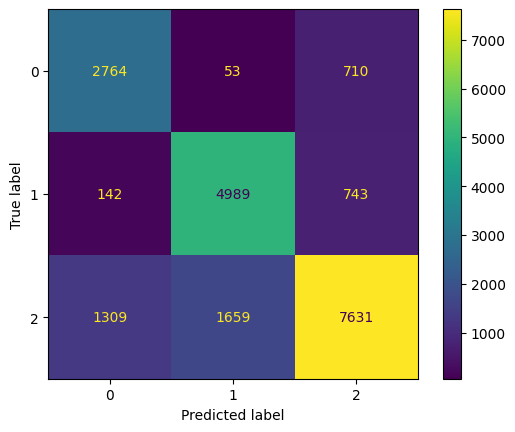

In [ ]:
cm = confusion_matrix(y_test, y_test_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.show()

DecisionTreeClassifier

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(

    X, y, test_size=0.2, random_state=42)

In [ ]:
%%time
perameters = {
  "max_depth" : [40, 50, 60],
  "min_samples_split" : [12, 22, 24],
  "min_samples_leaf" : [6, 12, 24],
  "criterion" : ["gini", "entropy"]
}
DTC = DecisionTreeClassifier()
grid_search = GridSearchCV(
    DTC,perameters,
    cv=5,
    return_train_score=True,
    scoring='accuracy'
)

search = grid_search.fit(X_train, y_train)

In [ ]:
print(f'Best perameters are: {search.best_params_}')
print(f'Best score is: {search.best_score_}')

Best perameters are: {'criterion': 'gini', 'max_depth': 60, 'min_samples_leaf': 6, 'min_samples_split': 22}
Best score is: 0.7337125


In [ ]:
cv_df = pd.DataFrame(search.cv_results_)

px.line(
    cv_df,
    y='mean_train_score',
    x='param_max_depth',
    color='param_criterion',
    width=800, height=400
)

In [ ]:
%%time
DTC_model = DecisionTreeClassifier(
    criterion='gini',
    max_depth=40,
    min_samples_split=12,
    min_samples_leaf=12
)
DTC_model.fit(X_train,y_train)
DTC_model.predict()

CPU times: user 1.57 s, sys: 75 µs, total: 1.57 s
Wall time: 1.63 s


DecisionTreeClassifier(max_depth=40, min_samples_leaf=12, min_samples_split=12)

In [ ]:
y_test_pred = DTC_model.predict(X_test)
report = classification_report(y_test, y_test_pred)
print(report)

              precision    recall  f1-score   support

           0       0.68      0.68      0.68      3527
           1       0.72      0.74      0.73      5874
           2       0.77      0.76      0.77     10599

    accuracy                           0.74     20000
   macro avg       0.72      0.73      0.73     20000
weighted avg       0.74      0.74      0.74     20000



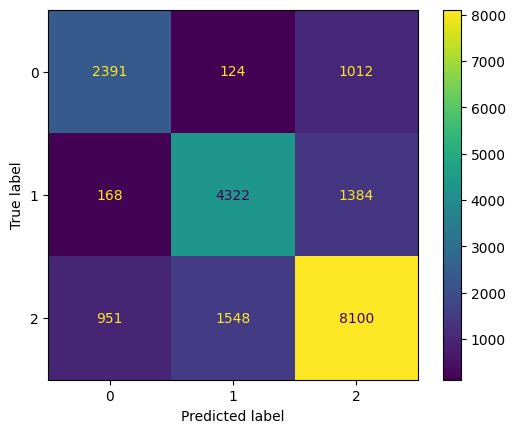

In [ ]:
cm = confusion_matrix(y_test, y_test_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.show()

SVC
Sicne we have a dataset of 100k we will use linearSVC

In [ ]:
lsvc = LinearSVC()

In [ ]:
%%time

lsvc_params = {
  "penalty" : ["l1", "l2"],
  "loss" : ["hinge", "squared_hinge"],
  "dual": [True, False],
}

lsvc_grid = GridSearchCV(
    lsvc,
    lsvc_params,
    cv=5,
    return_train_score=True,
    scoring='accuracy'
)

lsvc_search = lsvc_grid.fit(X_train, y_train)

print(f'Best perameters are: {search.best_params_}')
print(f'Best score is: {search.best_score_}')

Parametros: {'dual': True, 'loss': 'hinge', 'penalty': 'l2'}
Puntaje: 0.6434625
CPU times: user 4min 12s, sys: 2.13 s, total: 4min 14s
Wall time: 4min 15s


In [ ]:
lsvc = LinearSVC(penalty='l2',loss='hinge',dual=True)
lsvc.fit(X_train,y_train)

LinearSVC(dual=True, loss='hinge')

              precision    recall  f1-score   support

           0       0.52      0.64      0.57      3527
           1       0.63      0.52      0.57      5874
           2       0.69      0.70      0.70     10599

    accuracy                           0.64     20000
   macro avg       0.61      0.62      0.61     20000
weighted avg       0.64      0.64      0.64     20000



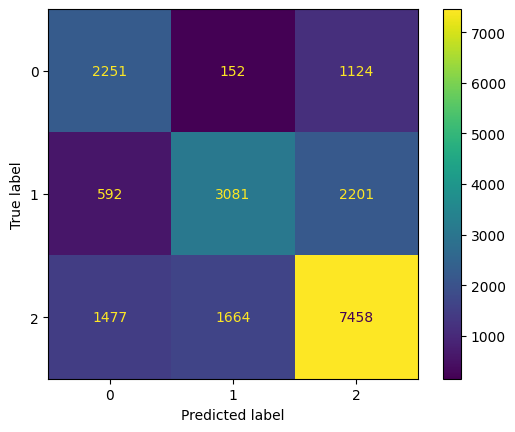

In [ ]:
y_test_pred = lsvc.predict(X_test)
report = classification_report(y_test, y_test_pred)
print(report)
cm = confusion_matrix(y_test, y_test_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.show()

RandomForestClassifier

In [ ]:
rfc = RandomForestClassifier()

In [ ]:
%%time
rfc_params = {
  "max_depth" : [None, 10, 15],
  "max_leaf_nodes" : [None, 10, 15],
  "min_samples_leaf" : [3, 4, 5],
  "min_samples_split" : [2, 4, 6],
  "n_estimators" : [100, 150, 200]
}

# Aplicamos la grilla al modelo

rfc_grid = HalvingGridSearchCV(
    rfc,
    param_grid=rfc_params,
    factor=4,
    cv=5,
    scoring='accuracy',
    n_jobs=-1,
    verbose=1
)
rfc_search = rfc_grid.fit(X_train, y_train)
print(f'Best perameters are: {search.best_params_}')
print(f'Best score is: {search.best_score_}')

n_iterations: 4
n_required_iterations: 4
n_possible_iterations: 4
min_resources_: 1250
max_resources_: 80000
aggressive_elimination: False
factor: 4
----------
iter: 0
n_candidates: 243
n_resources: 1250
Fitting 5 folds for each of 243 candidates, totalling 1215 fits
----------
iter: 1
n_candidates: 61
n_resources: 5000
Fitting 5 folds for each of 61 candidates, totalling 305 fits
----------
iter: 2
n_candidates: 16
n_resources: 20000
Fitting 5 folds for each of 16 candidates, totalling 80 fits
----------
iter: 3
n_candidates: 4
n_resources: 80000
Fitting 5 folds for each of 4 candidates, totalling 20 fits
Best perameters are: {'criterion': 'gini', 'max_depth': 60, 'min_samples_leaf': 6, 'min_samples_split': 22}
Best score is: 0.7337125
CPU times: user 47.6 s, sys: 6.43 s, total: 54 s
Wall time: 22min 45s


In [ ]:
best_est={'max_depth': None, 'max_leaf_nodes': None, 'min_samples_leaf': 3, 'min_samples_split': 6, 'n_estimators': 150}

In [ ]:
rfc_be = rfc_grid.best_estimator_
rfc_be.fit(X_train, y_train)

RandomForestClassifier(min_samples_leaf=3, n_estimators=150)

              precision    recall  f1-score   support

           0       0.77      0.76      0.77      3527
           1       0.80      0.83      0.81      5874
           2       0.83      0.81      0.82     10599

    accuracy                           0.81     20000
   macro avg       0.80      0.80      0.80     20000
weighted avg       0.81      0.81      0.81     20000



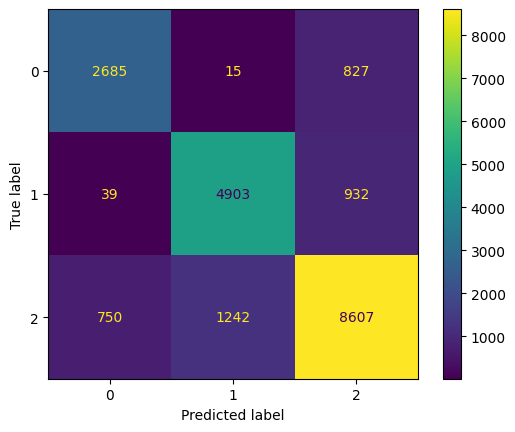

In [ ]:
y_test_pred = rfc_be.predict(X_test)
report = classification_report(y_test, y_test_pred)
print(report)
cm = confusion_matrix(y_test, y_test_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.show()

LogisticRegression
- Accuracy: 0.63

KNeighborsClassifier
- Accuracy: 0.77

DecisionTreeClassifier
- Accuracy: 0.74

LinearSVC
- Accuracy: 0.64

RandomForestClassifier
- Accuracy: 0.81
